In [57]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import plotly.express as px

from sklearn.cluster import KMeans
from sklearn.utils import shuffle
from scipy.stats import zscore
from skimage import data
from sklearn.feature_extraction.text import TfidfVectorizer


from sklearn.preprocessing import LabelEncoder, StandardScaler
from wordcloud import WordCloud,STOPWORDS
from sklearn.naive_bayes import MultinomialNB


import nltk
from nltk.corpus import stopwords



from bs4 import BeautifulSoup
import re, string, unicodedata

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
from sklearn.model_selection import train_test_split
from string import punctuation

from sklearn.ensemble import RandomForestClassifier

import warnings
warnings.filterwarnings("ignore")

In [58]:
# https://www.kaggle.com/datasets/kamilpytlak/personal-key-indicators-of-heart-disease
# https://www.kaggle.com/datasets/shubh0799/fake-news

In [59]:
df = pd.read_csv("heart_2020_cleaned.csv")
numerical = df.select_dtypes(exclude='object')
n = len(numerical)
num_cols = df.select_dtypes(exclude='object').columns
for col in numerical:
  Q1, Q3 = df[col].quantile([0.25,0.75])
  IQR = Q3 - Q1
  right = Q3 + 1.5 * IQR
  left = Q1 - 1.5 * IQR
  n = len(df.loc[(df[col] < left) | (df[col] > right)])
  print(f"{col}:\n\tOutlier Num = {n}\n\tOutlier Percentage = {n*100/len(df):.2f}%\n")
zs = df.copy()
for col in num_cols:
  zs[col] = zscore(zs[col])
outscores = np.abs(zs[num_cols])
no_outliers = (outscores<=3.3).all(axis=1)
df = df[no_outliers]

BMI:
	Outlier Num = 10396
	Outlier Percentage = 3.25%

PhysicalHealth:
	Outlier Num = 47146
	Outlier Percentage = 14.74%

MentalHealth:
	Outlier Num = 51576
	Outlier Percentage = 16.13%

SleepTime:
	Outlier Num = 4543
	Outlier Percentage = 1.42%



In [60]:
label_encoder = LabelEncoder()
categorical_features = ['HeartDisease', 'Smoking', 'AlcoholDrinking', 'Stroke', 'DiffWalking', 'PhysicalActivity','Asthma', 'KidneyDisease', 'SkinCancer', 'Sex', 'Race']
for feature in categorical_features:
    print(df[feature].unique())
    df[feature]=label_encoder.fit_transform(df[feature])
    print(df[feature].unique())

df['AgeCategory'] = df['AgeCategory'].replace({'18-24':0, '25-29':1, '30-34':2, '35-39':3, '40-44':4, '45-49':5, '50-54':6, '55-59':7, '60-64':8, '65-69':9, '70-74':10, '75-79':11, '80 or older':12})

df['GenHealth'] = df['GenHealth'].replace({'Poor':0, 'Fair':1, 'Good':2, 'Very good':3, 'Excellent':4})

df['Diabetic'] = df['Diabetic'].replace({'No':0, 'No, borderline diabetes':1, 'Yes (during pregnancy)':2, 'Yes':3})

['No' 'Yes']
[0 1]
['Yes' 'No']
[1 0]
['No' 'Yes']
[0 1]
['No' 'Yes']
[0 1]
['No' 'Yes']
[0 1]
['Yes' 'No']
[1 0]
['Yes' 'No']
[1 0]
['No' 'Yes']
[0 1]
['Yes' 'No']
[1 0]
['Female' 'Male']
[0 1]
['White' 'Black' 'Asian' 'American Indian/Alaskan Native' 'Other'
 'Hispanic']
[5 2 1 0 4 3]


In [61]:
df

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,Sex,AgeCategory,Race,Diabetic,PhysicalActivity,GenHealth,SleepTime,Asthma,KidneyDisease,SkinCancer
0,0,16.60,1,0,0,3.0,30.0,0,0,7,5,3,1,3,5.0,1,0,1
1,0,20.34,0,0,1,0.0,0.0,0,0,12,5,0,1,3,7.0,0,0,0
2,0,26.58,1,0,0,20.0,30.0,0,1,9,5,3,1,1,8.0,1,0,0
3,0,24.21,0,0,0,0.0,0.0,0,0,11,5,0,0,2,6.0,0,0,1
4,0,23.71,0,0,0,28.0,0.0,1,0,4,5,0,1,3,8.0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319789,0,22.22,0,0,0,0.0,0.0,0,0,0,3,0,1,4,8.0,0,0,0
319790,1,27.41,1,0,0,7.0,0.0,1,1,8,3,3,0,1,6.0,1,0,0
319791,0,29.84,1,0,0,0.0,0.0,0,1,3,3,0,1,3,5.0,1,0,0
319792,0,24.24,0,0,0,0.0,0.0,0,0,5,3,0,1,2,6.0,0,0,0


In [62]:
df = df[:100000]

In [63]:
x = df.drop('HeartDisease', axis=1)
y = df['HeartDisease']
scaler = StandardScaler()
X_std = scaler.fit_transform(x)

In [64]:
pca = PCA(n_components=2).fit(X_std)
X_pca= pca.transform(X_std)


In [65]:
X_tsne = TSNE(n_components=2).fit_transform(X_std)

In [66]:
X_pca[:5], X_tsne[:5]

(array([[ 1.6251689 ,  0.73939388],
        [ 0.21956653, -1.82071796],
        [ 3.94357707,  2.0072878 ],
        [ 0.73476899, -1.86720632],
        [ 2.31499278,  0.88325835]]),
 array([[-35.786846,  34.958847],
        [ -8.967341, -32.818047],
        [-35.94458 ,  14.080193],
        [-30.388308,  45.448925],
        [ 27.402287,   2.794545]], dtype=float32))

In [67]:
labels_pca = {
            str(i): f"PC {i+1} ({var:.1f}%)" 
            for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}
labels_tsne = {'0': 'TS 1', '1': 'TS 2'}
fig1 = px.scatter_matrix(X_pca, labels=labels_pca, dimensions=range(2), color=df['HeartDisease'], title = 'PCA')
fig2 = px.scatter_matrix(X_tsne, labels=labels_tsne, dimensions=range(2), color=df['HeartDisease'], title = 'TSNE')
fig1.show()
fig2.show()

In [68]:
image = data.rocket()

In [69]:
def color_quantization_k_means(image, n_colors):
    image = np.array(image, dtype=np.float64) / 255

    # Load Image and transform to a 2D numpy array.
    w, h, d = original_shape = tuple(image.shape)
    assert d == 3
    image_array = np.reshape(image, (w * h, d))
    image_array_sample = shuffle(image_array, random_state=0)[:1000]
    kmeans = KMeans(n_clusters=n_colors, random_state=0).fit(image_array_sample)

    # Get labels for all points
    labels = kmeans.predict(image_array)



    def recreate_image(codebook, labels, w, h):
        """Recreate the (compressed) image from the code book & labels"""
        d = codebook.shape[1]
        image = np.zeros((w, h, d))
        label_idx = 0
        for i in range(w):
            for j in range(h):
                image[i][j] = codebook[labels[label_idx]]
                label_idx += 1
        return image
    
    # Display all results, alongside original image
    plt.figure(1)
    plt.clf()
    plt.axis('off')
    plt.title('Original image')
    plt.imshow(image)

    plt.figure(2)
    plt.clf()
    plt.axis('off')
    plt.title(f'Quantized image ({n_colors} colors, K-Means)'  )
    plt.imshow(recreate_image(kmeans.cluster_centers_, labels, w, h))
    

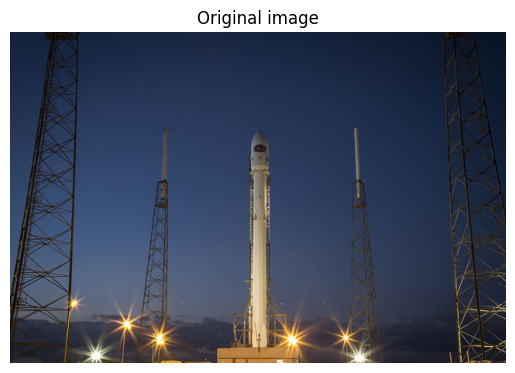

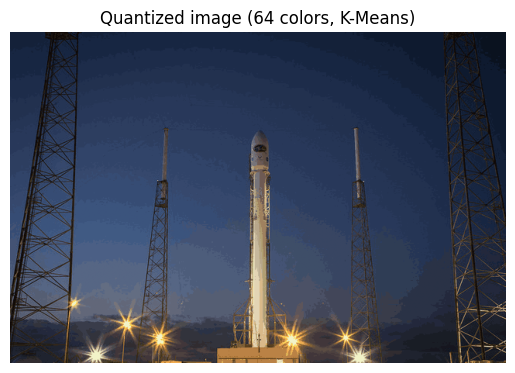

In [70]:
color_quantization_k_means(image, n_colors=64)

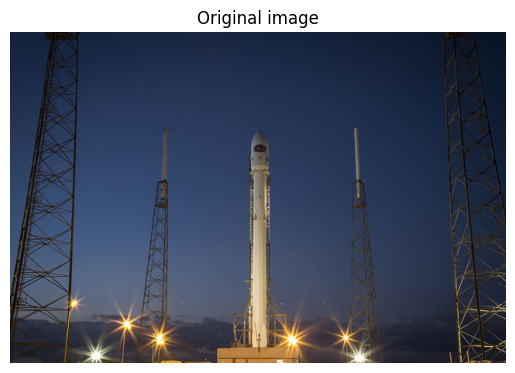

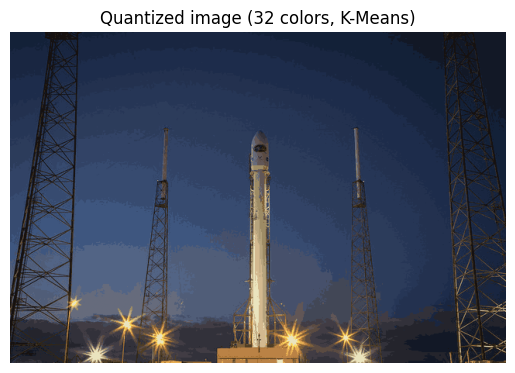

In [71]:
color_quantization_k_means(image, n_colors=32)

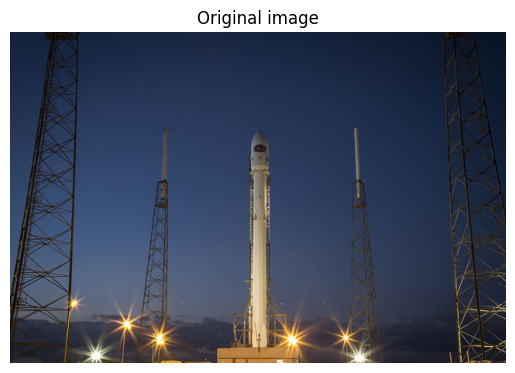

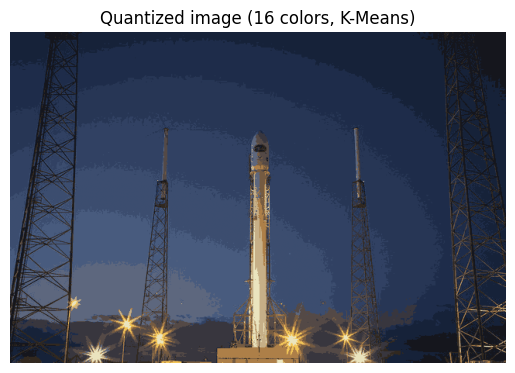

In [72]:
color_quantization_k_means(image, n_colors=16)

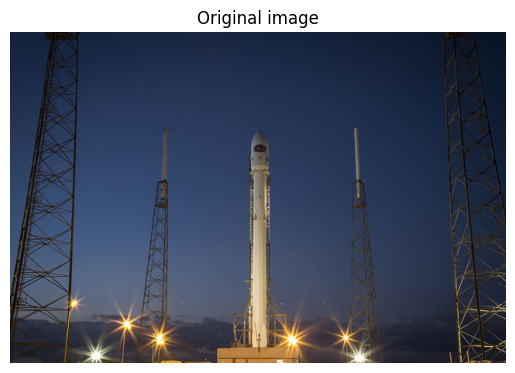

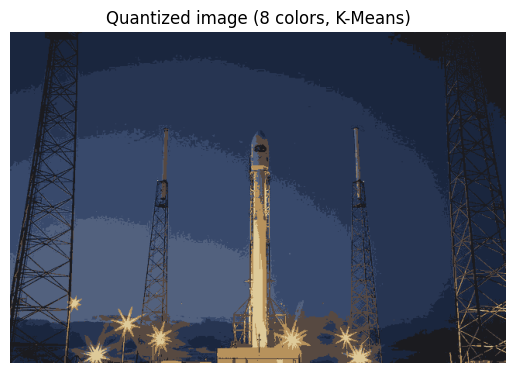

In [73]:
color_quantization_k_means(image, n_colors=8)

In [74]:
df = pd.read_csv('news.csv')

In [75]:
# from nltk.corpus import stopwords
# stop_words = set(stopwords.words('english')) #set of all stopwords
# punctuation = list(string.punctuation) #all punctuation
# #adding everything into one set
# stop_words.update(punctuation)

In [76]:
df['label'] = df['label'].replace('FAKE', 0)
df['label'] = df['label'].replace('REAL', 1)
df.drop('Unnamed: 0', axis =1 , inplace = True)

In [77]:
df.isna().sum()

title    0
text     0
label    0
dtype: int64

In [78]:
def strip_html(text):
    soup = BeautifulSoup(text, 'html.parser')
    return soup.get_text()

def square_brackets(text):
    return re.sub('\[[^]]*\]', '', text)

def url_extract(text):
    return re.sub(r'http\S+', '', text)

def stopwords(text):
    final_text = []
    for i in text.split():
        #checking in stopwords and also lowering the text
        if i.strip().lower() not in STOPWORDS:
            final_text.append(i.strip())
    return " ".join(final_text)

#finally getting all outputs in preprocessing the text using above functions
def preprocess(text):
    text = strip_html(text)
    text = square_brackets(text)
    text = url_extract(text)
    text = stopwords(text)
    return text

In [79]:
df['text'] = df['text'].apply(preprocess)

(-0.5, 1599.5, 799.5, -0.5)

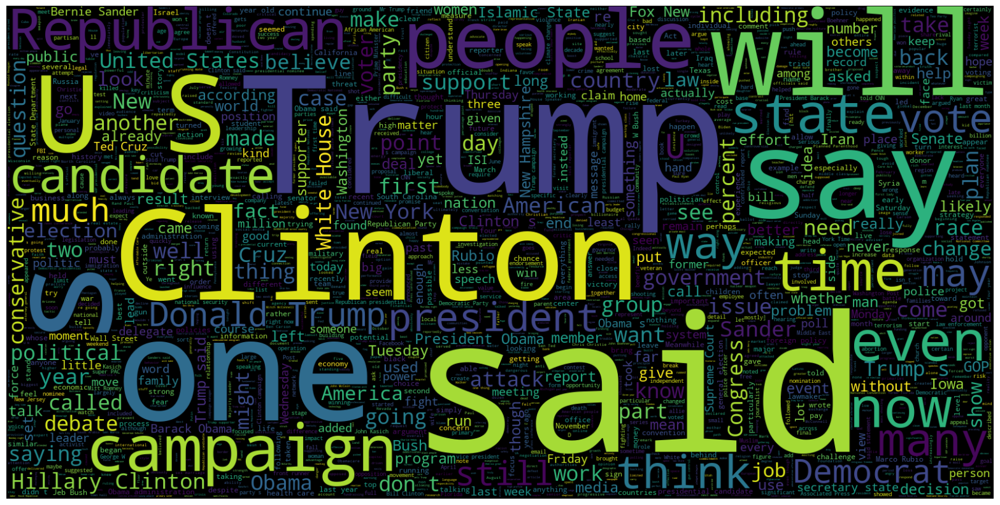

In [80]:
# Real news text
plt.figure(figsize = (20,20)) 

wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , 
               stopwords = STOPWORDS).generate(" ".join(df[df.label == 1].text))
plt.imshow(wc , interpolation = 'bilinear')
plt.axis('off')

(-0.5, 1599.5, 799.5, -0.5)

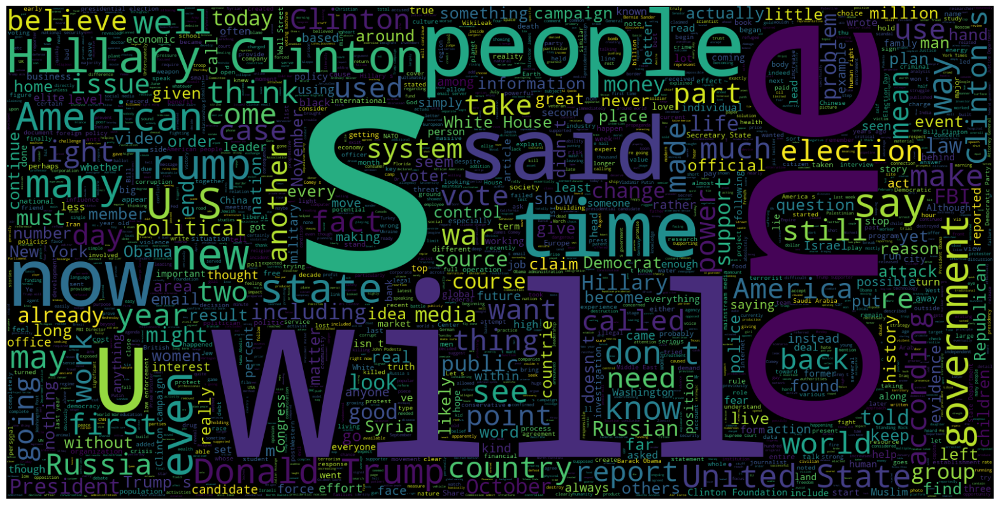

In [81]:
# Fake news text
plt.figure(figsize = (20,20)) 

wc = WordCloud(max_words = 2000 , width = 1600 , height = 800 , 
               stopwords = STOPWORDS).generate(" ".join(df[df.label == 0].text))
plt.imshow(wc , interpolation = 'bilinear')
plt.axis('off')

In [82]:
x_train, x_test, y_train, y_test = train_test_split(df['text'], df['label'], test_size=0.2, random_state=7)
#DataFlair - Initialize a TfidfVectorizer
tfidf_vectorizer= TfidfVectorizer(stop_words='english', max_df=0.7)

#DataFlair - Fit and transform train set, transform test set
tfidf_train=tfidf_vectorizer.fit_transform(x_train) 
tfidf_test=tfidf_vectorizer.transform(x_test)

In [83]:
clf = MultinomialNB(alpha=0.1)
clf.fit(tfidf_train, y_train)
y_pred = clf.predict(tfidf_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.95      0.87      0.90       638
           1       0.87      0.95      0.91       629

    accuracy                           0.91      1267
   macro avg       0.91      0.91      0.91      1267
weighted avg       0.91      0.91      0.91      1267



In [84]:
print(confusion_matrix(y_test, y_pred))

[[552  86]
 [ 32 597]]


In [85]:
for i in range (20, 51):
    forest = RandomForestClassifier (criterion='entropy', n_estimators = i)
    forest.fit(tfidf_train, y_train) 
    y_pred = forest.predict(tfidf_test)
    print ('Number of trees: ', i)
    accuracy = accuracy_score(y_test, y_pred)
    print("Accuracy: ", accuracy)

Number of trees:  20
Accuracy:  0.8689818468823993
Number of trees:  21
Accuracy:  0.8524072612470402
Number of trees:  22
Accuracy:  0.8902920284135754
Number of trees:  23
Accuracy:  0.8752959747434885
Number of trees:  24
Accuracy:  0.8871349644830308
Number of trees:  25
Accuracy:  0.8721389108129439
Number of trees:  26
Accuracy:  0.8823993685872139
Number of trees:  27
Accuracy:  0.8800315706393055
Number of trees:  28
Accuracy:  0.8855564325177585
Number of trees:  29
Accuracy:  0.8863456985003947
Number of trees:  30
Accuracy:  0.8855564325177585
Number of trees:  31
Accuracy:  0.8997632202052092
Number of trees:  32
Accuracy:  0.8855564325177585
Number of trees:  33
Accuracy:  0.9005524861878453
Number of trees:  34
Accuracy:  0.8808208366219415
Number of trees:  35
Accuracy:  0.8823993685872139
Number of trees:  36
Accuracy:  0.8855564325177585
Number of trees:  37
Accuracy:  0.8839779005524862
Number of trees:  38
Accuracy:  0.8926598263614838
Number of trees:  39
Accuracy: 